In [586]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from pandas_profiling import ProfileReport
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import LabelEncoder
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
import statsmodels.api as sm

pd.set_option('display.max_columns', None)

%matplotlib inline

In [501]:
data = pd.read_csv('Automobile_data.csv')

In [502]:
data

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,length,width,height,curb-weight,engine-type,num-of-cylinders,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
0,3,?,alfa-romero,gas,std,two,convertible,rwd,front,88.6,168.8,64.1,48.8,2548,dohc,four,130,mpfi,3.47,2.68,9.0,111,5000,21,27,13495
1,3,?,alfa-romero,gas,std,two,convertible,rwd,front,88.6,168.8,64.1,48.8,2548,dohc,four,130,mpfi,3.47,2.68,9.0,111,5000,21,27,16500
2,1,?,alfa-romero,gas,std,two,hatchback,rwd,front,94.5,171.2,65.5,52.4,2823,ohcv,six,152,mpfi,2.68,3.47,9.0,154,5000,19,26,16500
3,2,164,audi,gas,std,four,sedan,fwd,front,99.8,176.6,66.2,54.3,2337,ohc,four,109,mpfi,3.19,3.4,10.0,102,5500,24,30,13950
4,2,164,audi,gas,std,four,sedan,4wd,front,99.4,176.6,66.4,54.3,2824,ohc,five,136,mpfi,3.19,3.4,8.0,115,5500,18,22,17450
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
200,-1,95,volvo,gas,std,four,sedan,rwd,front,109.1,188.8,68.9,55.5,2952,ohc,four,141,mpfi,3.78,3.15,9.5,114,5400,23,28,16845
201,-1,95,volvo,gas,turbo,four,sedan,rwd,front,109.1,188.8,68.8,55.5,3049,ohc,four,141,mpfi,3.78,3.15,8.7,160,5300,19,25,19045
202,-1,95,volvo,gas,std,four,sedan,rwd,front,109.1,188.8,68.9,55.5,3012,ohcv,six,173,mpfi,3.58,2.87,8.8,134,5500,18,23,21485
203,-1,95,volvo,diesel,turbo,four,sedan,rwd,front,109.1,188.8,68.9,55.5,3217,ohc,six,145,idi,3.01,3.4,23.0,106,4800,26,27,22470


In [503]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 205 entries, 0 to 204
Data columns (total 26 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   symboling          205 non-null    int64  
 1   normalized-losses  205 non-null    object 
 2   make               205 non-null    object 
 3   fuel-type          205 non-null    object 
 4   aspiration         205 non-null    object 
 5   num-of-doors       205 non-null    object 
 6   body-style         205 non-null    object 
 7   drive-wheels       205 non-null    object 
 8   engine-location    205 non-null    object 
 9   wheel-base         205 non-null    float64
 10  length             205 non-null    float64
 11  width              205 non-null    float64
 12  height             205 non-null    float64
 13  curb-weight        205 non-null    int64  
 14  engine-type        205 non-null    object 
 15  num-of-cylinders   205 non-null    object 
 16  engine-size        205 non

In [504]:
ProfileReport(data,dark_mode= True,)

<AxesSubplot:>

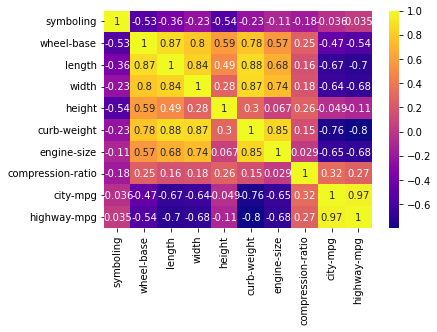

In [505]:
sns.heatmap(data.corr(),cmap='plasma',annot=True)

In [506]:
# Null values are represented by ?, it needs to be changed to np.nan
df = data.copy()
df = df.replace('?',np.NaN)

In [507]:
df.sample(10)

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,length,width,height,curb-weight,engine-type,num-of-cylinders,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
38,0,106,honda,gas,std,two,hatchback,fwd,front,96.5,167.5,65.2,53.3,2289,ohc,four,110,1bbl,3.15,3.58,9.0,86,5800,27,33,9095
20,0,81,chevrolet,gas,std,four,sedan,fwd,front,94.5,158.8,63.6,52.0,1909,ohc,four,90,2bbl,3.03,3.11,9.6,70,5400,38,43,6575
87,1,125,mitsubishi,gas,turbo,four,sedan,fwd,front,96.3,172.4,65.4,51.6,2403,ohc,four,110,spdi,3.17,3.46,7.5,116,5500,23,30,9279
161,0,91,toyota,gas,std,four,hatchback,fwd,front,95.7,166.3,64.4,52.8,2122,ohc,four,98,2bbl,3.19,3.03,9.0,70,4800,28,34,8358
114,0,NaN,peugot,diesel,turbo,four,wagon,rwd,front,114.2,198.9,68.4,58.7,3485,l,four,152,idi,3.7,3.52,21.0,95,4150,25,25,17075
182,2,122,volkswagen,diesel,std,two,sedan,fwd,front,97.3,171.7,65.5,55.7,2261,ohc,four,97,idi,3.01,3.4,23.0,52,4800,37,46,7775
101,0,128,nissan,gas,std,four,sedan,fwd,front,100.4,181.7,66.5,55.1,3095,ohcv,six,181,mpfi,3.43,3.27,9.0,152,5200,17,22,13499
178,3,197,toyota,gas,std,two,hatchback,rwd,front,102.9,183.5,67.7,52.0,2976,dohc,six,171,mpfi,3.27,3.35,9.3,161,5200,20,24,16558
135,2,104,saab,gas,std,four,sedan,fwd,front,99.1,186.6,66.5,56.1,2758,ohc,four,121,mpfi,3.54,3.07,9.3,110,5250,21,28,15510
168,2,134,toyota,gas,std,two,hardtop,rwd,front,98.4,176.2,65.6,52.0,2536,ohc,four,146,mpfi,3.62,3.5,9.3,116,4800,24,30,9639


In [508]:
df.isnull().sum()

symboling             0
normalized-losses    41
make                  0
fuel-type             0
aspiration            0
num-of-doors          2
body-style            0
drive-wheels          0
engine-location       0
wheel-base            0
length                0
width                 0
height                0
curb-weight           0
engine-type           0
num-of-cylinders      0
engine-size           0
fuel-system           0
bore                  4
stroke                4
compression-ratio     0
horsepower            2
peak-rpm              2
city-mpg              0
highway-mpg           0
price                 4
dtype: int64

In [509]:
df.dropna(axis=0,subset=['price','bore','stroke','horsepower','peak-rpm','num-of-doors'], inplace=True)

In [510]:
df.sample(5)

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,length,width,height,curb-weight,engine-type,num-of-cylinders,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
50,1,104,mazda,gas,std,two,hatchback,fwd,front,93.1,159.1,64.2,54.1,1890,ohc,four,91,2bbl,3.03,3.15,9.0,68,5000,30,31,5195
52,1,104,mazda,gas,std,two,hatchback,fwd,front,93.1,159.1,64.2,54.1,1905,ohc,four,91,2bbl,3.03,3.15,9.0,68,5000,31,38,6795
151,1,87,toyota,gas,std,two,hatchback,fwd,front,95.7,158.7,63.6,54.5,2040,ohc,four,92,2bbl,3.05,3.03,9.0,62,4800,31,38,6338
59,1,129,mazda,gas,std,two,hatchback,fwd,front,98.8,177.8,66.5,53.7,2385,ohc,four,122,2bbl,3.39,3.39,8.6,84,4800,26,32,8845
186,2,94,volkswagen,gas,std,four,sedan,fwd,front,97.3,171.7,65.5,55.7,2275,ohc,four,109,mpfi,3.19,3.4,9.0,85,5250,27,34,8495


In [511]:
df = df.replace('?', np.nan)
df['normalized-losses'] = pd.to_numeric(df['normalized-losses'])
df['normalized-losses'].fillna(df['normalized-losses'].mean(), inplace=True)

In [512]:
# df[df['normalized-losses'] == null]

In [513]:
df['normalized-losses']

0      121.132075
1      121.132075
2      121.132075
3      164.000000
4      164.000000
          ...    
200     95.000000
201     95.000000
202     95.000000
203     95.000000
204     95.000000
Name: normalized-losses, Length: 193, dtype: float64

In [514]:
df['normalized-losses'].astype('int64')

0      121
1      121
2      121
3      164
4      164
      ... 
200     95
201     95
202     95
203     95
204     95
Name: normalized-losses, Length: 193, dtype: int64

In [515]:
df['normalized-losses'].fillna(df['normalized-losses'].mean(), inplace=True)

In [516]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 193 entries, 0 to 204
Data columns (total 26 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   symboling          193 non-null    int64  
 1   normalized-losses  193 non-null    float64
 2   make               193 non-null    object 
 3   fuel-type          193 non-null    object 
 4   aspiration         193 non-null    object 
 5   num-of-doors       193 non-null    object 
 6   body-style         193 non-null    object 
 7   drive-wheels       193 non-null    object 
 8   engine-location    193 non-null    object 
 9   wheel-base         193 non-null    float64
 10  length             193 non-null    float64
 11  width              193 non-null    float64
 12  height             193 non-null    float64
 13  curb-weight        193 non-null    int64  
 14  engine-type        193 non-null    object 
 15  num-of-cylinders   193 non-null    object 
 16  engine-size        193 non

In [517]:
df

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,length,width,height,curb-weight,engine-type,num-of-cylinders,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
0,3,121.132075,alfa-romero,gas,std,two,convertible,rwd,front,88.6,168.8,64.1,48.8,2548,dohc,four,130,mpfi,3.47,2.68,9.0,111,5000,21,27,13495
1,3,121.132075,alfa-romero,gas,std,two,convertible,rwd,front,88.6,168.8,64.1,48.8,2548,dohc,four,130,mpfi,3.47,2.68,9.0,111,5000,21,27,16500
2,1,121.132075,alfa-romero,gas,std,two,hatchback,rwd,front,94.5,171.2,65.5,52.4,2823,ohcv,six,152,mpfi,2.68,3.47,9.0,154,5000,19,26,16500
3,2,164.000000,audi,gas,std,four,sedan,fwd,front,99.8,176.6,66.2,54.3,2337,ohc,four,109,mpfi,3.19,3.4,10.0,102,5500,24,30,13950
4,2,164.000000,audi,gas,std,four,sedan,4wd,front,99.4,176.6,66.4,54.3,2824,ohc,five,136,mpfi,3.19,3.4,8.0,115,5500,18,22,17450
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
200,-1,95.000000,volvo,gas,std,four,sedan,rwd,front,109.1,188.8,68.9,55.5,2952,ohc,four,141,mpfi,3.78,3.15,9.5,114,5400,23,28,16845
201,-1,95.000000,volvo,gas,turbo,four,sedan,rwd,front,109.1,188.8,68.8,55.5,3049,ohc,four,141,mpfi,3.78,3.15,8.7,160,5300,19,25,19045
202,-1,95.000000,volvo,gas,std,four,sedan,rwd,front,109.1,188.8,68.9,55.5,3012,ohcv,six,173,mpfi,3.58,2.87,8.8,134,5500,18,23,21485
203,-1,95.000000,volvo,diesel,turbo,four,sedan,rwd,front,109.1,188.8,68.9,55.5,3217,ohc,six,145,idi,3.01,3.4,23.0,106,4800,26,27,22470


In [518]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 193 entries, 0 to 204
Data columns (total 26 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   symboling          193 non-null    int64  
 1   normalized-losses  193 non-null    float64
 2   make               193 non-null    object 
 3   fuel-type          193 non-null    object 
 4   aspiration         193 non-null    object 
 5   num-of-doors       193 non-null    object 
 6   body-style         193 non-null    object 
 7   drive-wheels       193 non-null    object 
 8   engine-location    193 non-null    object 
 9   wheel-base         193 non-null    float64
 10  length             193 non-null    float64
 11  width              193 non-null    float64
 12  height             193 non-null    float64
 13  curb-weight        193 non-null    int64  
 14  engine-type        193 non-null    object 
 15  num-of-cylinders   193 non-null    object 
 16  engine-size        193 non

In [519]:
df['normalized-losses'].fillna(df['normalized-losses'].mean())

0      121.132075
1      121.132075
2      121.132075
3      164.000000
4      164.000000
          ...    
200     95.000000
201     95.000000
202     95.000000
203     95.000000
204     95.000000
Name: normalized-losses, Length: 193, dtype: float64

In [520]:
df.select_dtypes(include=np.number).columns.tolist()

['symboling',
 'normalized-losses',
 'wheel-base',
 'length',
 'width',
 'height',
 'curb-weight',
 'engine-size',
 'compression-ratio',
 'city-mpg',
 'highway-mpg']

In [521]:
# imputer = SimpleImputer(missing_values=np.nan, strategy='mean')
# imputer = imputer.fit(df['normalized-losses'])

In [467]:
df['normalized-losses'].astype(str).astype(int)

ValueError: invalid literal for int() with base 10: '121.13207547169812'

In [522]:
df['normalized-losses'] = df['normalized-losses'].replace(np.NaN,0)
# df['normalized-losses'] = df['normalized-losses'].astype(str).astype(int)

In [523]:
# Converting column type to numeric and replacing '?' with mean value
num_col = ['normalized-losses', 'bore',  'stroke', 'horsepower', 'peak-rpm','price']
for col in num_col:
    df[col] = df[col].replace('?', np.nan)
    df[col] = pd.to_numeric(df[col])
    df[col].fillna(df[col].mean(), inplace=True)
df.head(10)

,symboling,normalized-losses,make,fuel-type,aspiration,num-of-doors,body-style,drive-wheels,engine-location,wheel-base,length,width,height,curb-weight,engine-type,num-of-cylinders,engine-size,fuel-system,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
0,3,121.132075,alfa-romero,gas,std,two,convertible,rwd,front,88.6,168.8,64.1,48.8,2548,dohc,four,130,mpfi,3.47,2.68,9.0,111,5000,21,27,13495
1,3,121.132075,alfa-romero,gas,std,two,convertible,rwd,front,88.6,168.8,64.1,48.8,2548,dohc,four,130,mpfi,3.47,2.68,9.0,111,5000,21,27,16500
2,1,121.132075,alfa-romero,gas,std,two,hatchback,rwd,front,94.5,171.2,65.5,52.4,2823,ohcv,six,152,mpfi,2.68,3.47,9.0,154,5000,19,26,16500
3,2,164.000000,audi,gas,std,four,sedan,fwd,front,99.8,176.6,66.2,54.3,2337,ohc,four,109,mpfi,3.19,3.40,10.0,102,5500,24,30,13950
4,2,164.000000,audi,gas,std,four,sedan,4wd,front,99.4,176.6,66.4,54.3,2824,ohc,five,136,mpfi,3.19,3.40,8.0,115,5500,18,22,17450
5,2,121.132075,audi,gas,std,two,sedan,fwd,front,99.8,177.3,66.3,53.1,2507,ohc,five,136,mpfi,3.19,3.40,8.5,110,5500,19,25,15250
6,1,158.000000,audi,gas,std,four,sedan,fwd,front,105.8,192.7,71.4,55.7,2844,ohc,five,136,mpfi,3.19,3.40,8.5,110,5500,19,25,17710
7,1,121.132075,audi,gas,std,four,wagon,fwd,front,105.8,192.7,71.4,55.7,2954,ohc,five,136,mpfi,3.19,3.40,8.5,110,5500,19,25,18920
8,1,158.000000,audi,gas,turbo,four,sedan,fwd,front,105.8,192.7,71.4,55.9,3086,ohc,five,131,mpfi,3.13,3.40,8.3,140,5500,17,20,23875
10,2,192.000000,bmw,gas,std,two,sedan,rwd,front,101.2,176.8,64.8,54.3,2395,ohc,four,108,mpfi,3.50,2.80,8.8,101,5800,23,29,16430


In [524]:
ProfileReport(df)

In [525]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 193 entries, 0 to 204
Data columns (total 26 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   symboling          193 non-null    int64  
 1   normalized-losses  193 non-null    float64
 2   make               193 non-null    object 
 3   fuel-type          193 non-null    object 
 4   aspiration         193 non-null    object 
 5   num-of-doors       193 non-null    object 
 6   body-style         193 non-null    object 
 7   drive-wheels       193 non-null    object 
 8   engine-location    193 non-null    object 
 9   wheel-base         193 non-null    float64
 10  length             193 non-null    float64
 11  width              193 non-null    float64
 12  height             193 non-null    float64
 13  curb-weight        193 non-null    int64  
 14  engine-type        193 non-null    object 
 15  num-of-cylinders   193 non-null    object 
 16  engine-size        193 non

In [526]:
print("List of Numerical features: " , df.select_dtypes(include=np.number).columns.tolist())
print('\n')
print('--'*50)
print("List of Categorical features: " , df.select_dtypes(include=['object']).columns.tolist())

List of Numerical features:  ['symboling', 'normalized-losses', 'wheel-base', 'length', 'width', 'height', 'curb-weight', 'engine-size', 'bore', 'stroke', 'compression-ratio', 'horsepower', 'peak-rpm', 'city-mpg', 'highway-mpg', 'price']


----------------------------------------------------------------------------------------------------
List of Categorical features:  ['make', 'fuel-type', 'aspiration', 'num-of-doors', 'body-style', 'drive-wheels', 'engine-location', 'engine-type', 'num-of-cylinders', 'fuel-system']


In [527]:
df.iloc[1]

symboling                      3
normalized-losses        121.132
make                 alfa-romero
fuel-type                    gas
aspiration                   std
num-of-doors                 two
body-style           convertible
drive-wheels                 rwd
engine-location            front
wheel-base                  88.6
length                     168.8
width                       64.1
height                      48.8
curb-weight                 2548
engine-type                 dohc
num-of-cylinders            four
engine-size                  130
fuel-system                 mpfi
bore                        3.47
stroke                      2.68
compression-ratio              9
horsepower                   111
peak-rpm                    5000
city-mpg                      21
highway-mpg                   27
price                      16500
Name: 1, dtype: object

In [528]:
# convert num-of-cylinders from object(letters) to figures
df['num-of-cylinders'].unique()

array(['four', 'six', 'five', 'three', 'twelve', 'eight'], dtype=object)

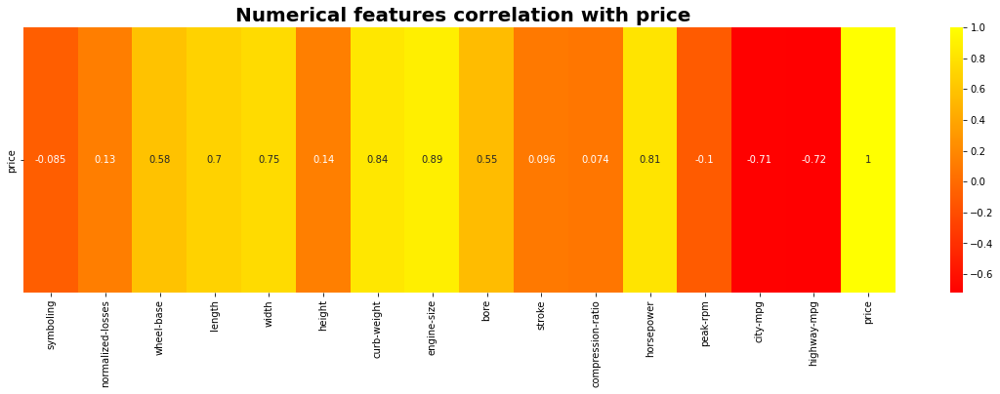

In [529]:
plt.figure(figsize=[20,5]);
plt.title(" Numerical features correlation with price", weight='bold', fontsize=20);
sns.heatmap(df.corr().sort_values(by=['price'], ascending=False).head(1), cmap='autumn', annot=True);

In [530]:
df.corr()['price'].sort_values(ascending=False).to_frame()

,price
price,1.000000
engine-size,0.888778
curb-weight,0.835368
horsepower,0.812453
width,0.754649
length,0.695928
wheel-base,0.584951
bore,0.546295
height,0.136234
normalized-losses,0.133654


Observation: The engine-size,curb-weight, horsepower have the highest correlation values with the price

In [531]:
# Analysis on categorical variable
category = df.select_dtypes(include=['object']).columns.tolist()
category

['make',
 'fuel-type',
 'aspiration',
 'num-of-doors',
 'body-style',
 'drive-wheels',
 'engine-location',
 'engine-type',
 'num-of-cylinders',
 'fuel-system']

In [ ]:
# sns.pairplot(data=df)

<AxesSubplot:xlabel='make', ylabel='Count'>

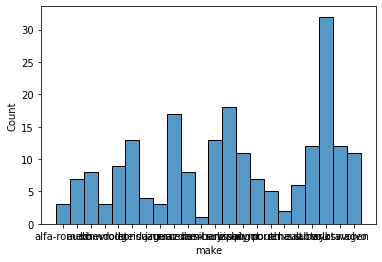

In [532]:
sns.histplot(data=data, x='make')

In [533]:
df['fuel-type'].unique()

array(['gas', 'diesel'], dtype=object)

In [534]:
df.make.value_counts().to_frame().head(4)

,make
toyota,32
nissan,18
honda,13
mitsubishi,13


Top brands [toyota,nissan,honda,mitsubishi]

<AxesSubplot:ylabel='make'>

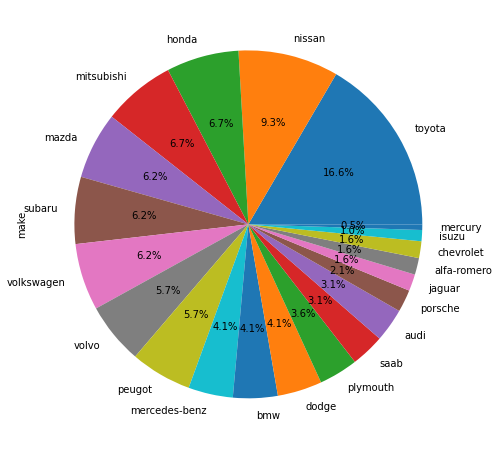

In [535]:
plt.figure(figsize=[20,5])
df.make.value_counts().plot.pie(autopct='%1.1f%%',figsize=(8,8))

<AxesSubplot:xlabel='fuel-type', ylabel='Count'>

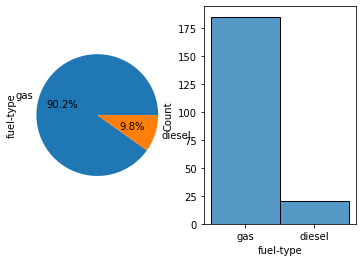

In [536]:
plt.subplot(1,2,1)
df['fuel-type'].value_counts().plot.pie(autopct='%1.1f%%');
plt.subplot(1,2,2)
sns.histplot(data=data, x='fuel-type')

Observation: gas is more than diesel

In [537]:
categorical[3:6]

['num-of-doors', 'body-style', 'drive-wheels']

In [ ]:
# Function to create barplots that indicate percentage for each category.
def bar_perc(plot, feature):
    '''
    plot
    feature: 1-d categorical feature array
    '''
    total = len(feature) # length of the column
    for p in plot.patches:
        percentage = '{:.1f}%'.format(100 * p.get_height()/total) # percentage of each class of the category
        x = p.get_x() + p.get_width() / 2 - 0.05 # width of the plot
        y = p.get_y() + p.get_height()           # hieght of the plot
        plot.annotate(percentage, (x, y), size = 12) # annotate the percentage

In [538]:
def uni_graph(variable=None):
    plt.figure(figsize=[20,5])
    plt.subplot(1,2,1)
    df[variable].value_counts().plot.pie(autopct='%1.1f%%');
    plt.subplot(1,2,2)
    sns.histplot(data=data, x=variable)

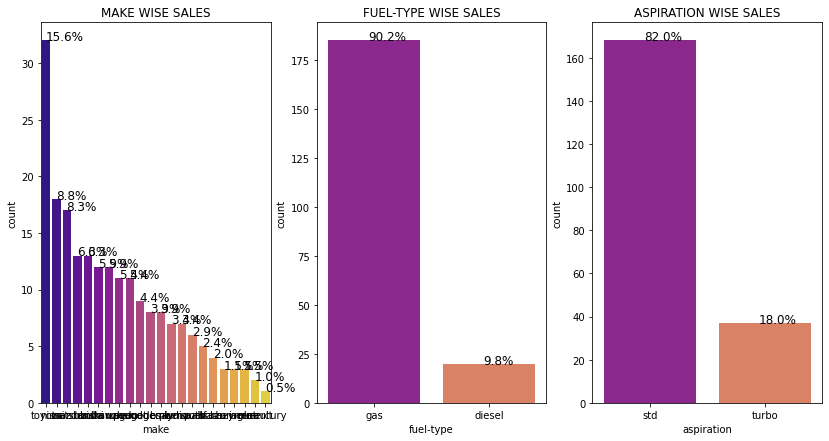

In [539]:
fig1, axes1 =plt.subplots(1,3,figsize=(14, 7))
j=0
for i in range(len(categorical[3:6])):
    order = data[category[i]].value_counts(ascending=False).index # to display bar in ascending order
    axis=sns.countplot(x=category[i], data=data , order=order,ax=axes1[i],palette='plasma').set(title=category[i].upper() + ' WISE SALES')
    bar_perc(axes1[i],data[category[i]])

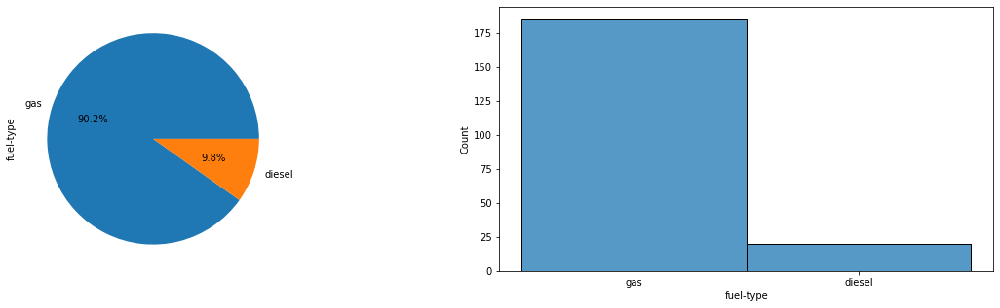

In [540]:
uni_graph('fuel-type')

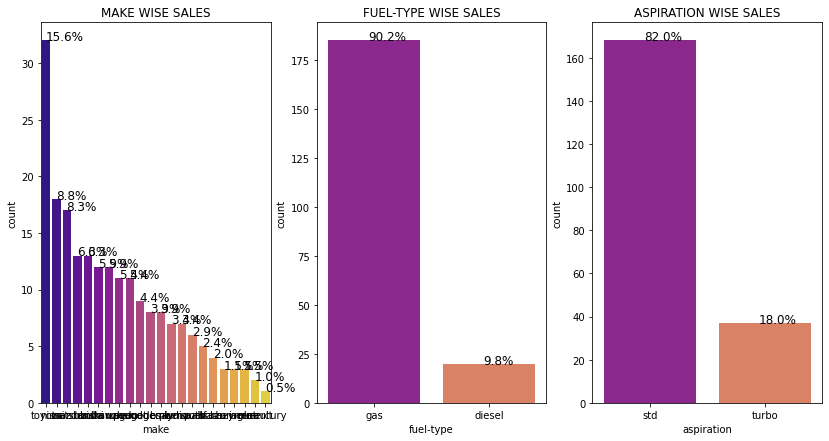

In [541]:
fig1, axes1 =plt.subplots(1,3,figsize=(14, 7))
j=0
for i in range(len(categorical[:3])):
    order = data[category[i]].value_counts(ascending=False).index # to display bar in ascending order
    axis=sns.countplot(x=category[i], data=data , order=order,ax=axes1[i],palette='plasma').set(title=category[i].upper() + ' WISE SALES')
    bar_perc(axes1[i],data[category[i]])

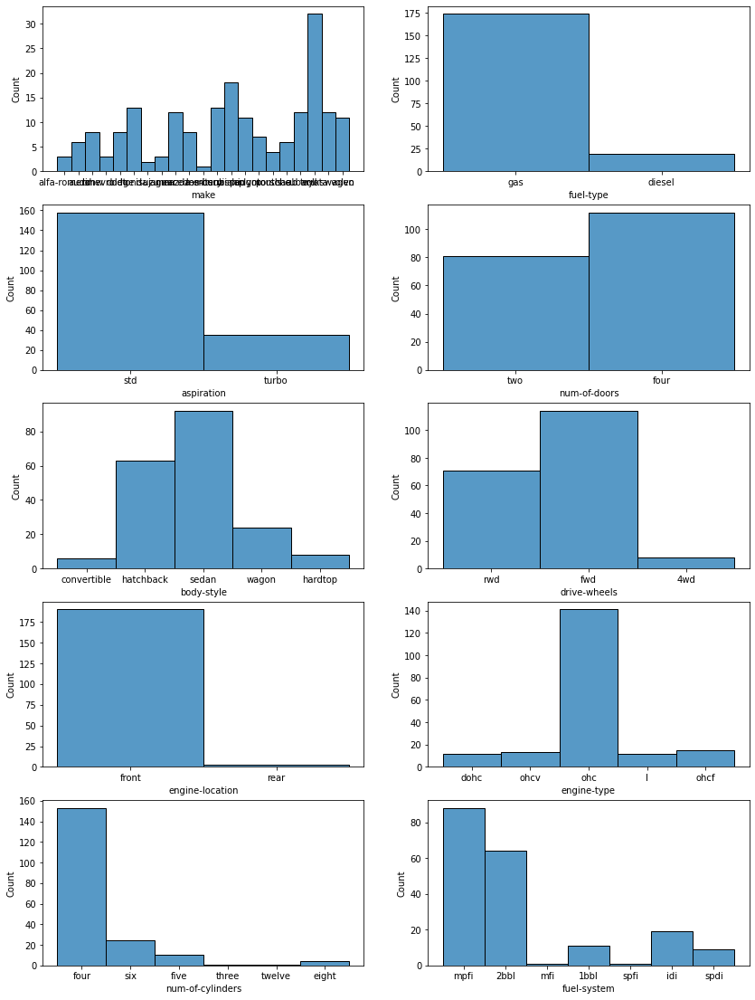

In [542]:
fig1, axes1 =plt.subplots(5,2,figsize=([14, 19]))
plt.subplots_adjust(left=None, bottom=None, right=None, top=0.9, wspace=None, hspace=None)
for i in range(len(category)):
    row=i//2
    col=i%2
    ax=axes1[row,col]
    
    sns.histplot(df[category[i]],ax=ax)
    

## Observation:

- fuel-type: gas > diesel
- aspiration: std > turbo
- num-of-doors: four > two
- body-style: sedan > hatchback > wagon > hardtop > convertible
- drive-wheels: fwd > rwd > 4wd
- engine-location: front > rear
- engine-type:  ohc > ohcf > ohcv >  l = dohc
- num-of-cylinders: four > six > five > eight > twelve = three
- fuel-system: mpfi > 2bbl > idi > lbbl > spdi > mfi = spfi

In [543]:
numeric_vars = df.select_dtypes(include=np.number).columns.tolist()

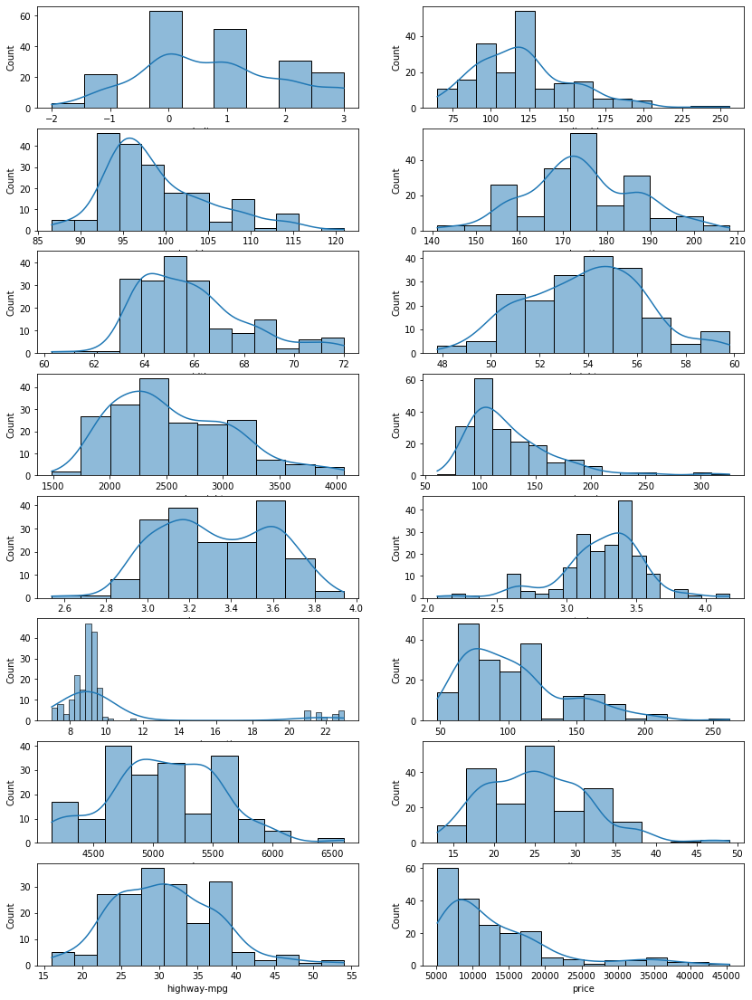

In [544]:
fig1, axes1 =plt.subplots(8,2,figsize=([14, 19]))
plt.subplots_adjust(left=None, bottom=None, right=None, top=0.9, wspace=None, hspace=None)
for i in range(len(numeric_vars)):
    row=i//2
    col=i%2
    ax=axes1[row,col]
    
    sns.histplot(df[numeric_vars[i]],ax=ax, kde=True)

## Feature Engineering

In [545]:
df.describe()

,symboling,normalized-losses,wheel-base,length,width,height,curb-weight,engine-size,bore,stroke,compression-ratio,horsepower,peak-rpm,city-mpg,highway-mpg,price
count,193.000000,193.000000,193.000000,193.000000,193.000000,193.000000,193.000000,193.000000,193.000000,193.000000,193.000000,193.000000,193.000000,193.000000,193.000000,193.000000
mean,0.797927,121.132075,98.923834,174.326425,65.893782,53.869948,2561.507772,128.124352,3.330622,3.248860,10.143627,103.481865,5099.740933,25.326425,30.787565,13285.025907
std,1.235582,32.340975,6.152409,12.478593,2.137795,2.394770,526.700026,41.590452,0.272385,0.315421,3.977491,37.960107,468.694369,6.387828,6.816910,8089.082886
min,-2.000000,65.000000,86.600000,141.100000,60.300000,47.800000,1488.000000,61.000000,2.540000,2.070000,7.000000,48.000000,4150.000000,13.000000,16.000000,5118.000000
25%,0.000000,95.000000,94.500000,166.300000,64.100000,52.000000,2145.000000,98.000000,3.150000,3.110000,8.500000,70.000000,4800.000000,19.000000,25.000000,7738.000000
50%,1.000000,121.132075,97.000000,173.200000,65.400000,54.100000,2414.000000,120.000000,3.310000,3.290000,9.000000,95.000000,5100.000000,25.000000,30.000000,10245.000000
75%,2.000000,134.000000,102.400000,184.600000,66.900000,55.700000,2952.000000,146.000000,3.590000,3.410000,9.400000,116.000000,5500.000000,30.000000,34.000000,16515.000000
max,3.000000,256.000000,120.900000,208.100000,72.000000,59.800000,4066.000000,326.000000,3.940000,4.170000,23.000000,262.000000,6600.000000,49.000000,54.000000,45400.000000


/Users/dougymenns/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/dougymenns/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
/Users/dougymenns/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinte

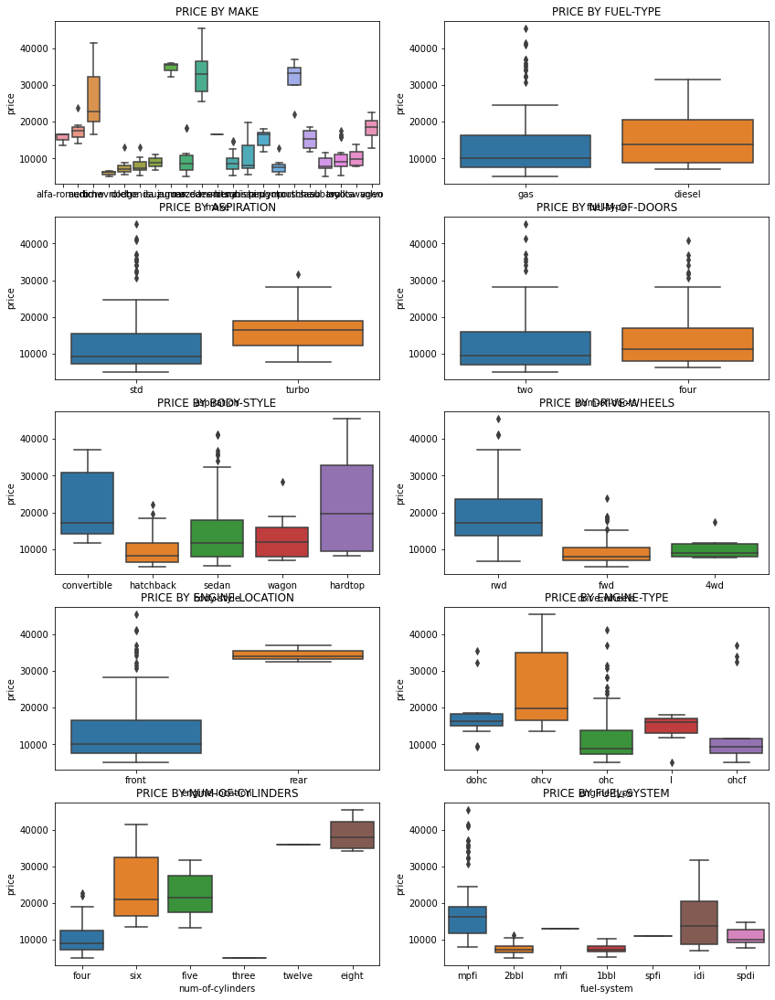

In [549]:
fig1, axes1 =plt.subplots(5,2,figsize=([14, 19]))
#instead of writing  boxplot 6 times using for loop
for i in range(len(category)):
    row=i//2
    col=i%2
    ax=axes1[row,col]
    
    sns.boxplot(df[category[i]],df['price'],ax=ax).set(title='PRICE BY ' + category[i].upper()  )

### Observations:
- Outliers: 

In [550]:
# rename columns
cols = df.columns.values
new_cols = []
for i in cols:
    new_cols.append(i.replace('-','_'))

    
df.columns = new_cols

In [431]:
len(numeric_vars)

11

In [551]:
# replacing letters with figures/values
df = df.replace({"num_of_doors":{"four": 4, "two": 2},
            "num_of_cylinders" : {"four": 4, "two": 2,"five": 5, "twelve": 12, "three": 3,"six":6,"eight":8}
           })

In [552]:
df

,symboling,normalized_losses,make,fuel_type,aspiration,num_of_doors,body_style,drive_wheels,engine_location,wheel_base,length,width,height,curb_weight,engine_type,num_of_cylinders,engine_size,fuel_system,bore,stroke,compression_ratio,horsepower,peak_rpm,city_mpg,highway_mpg,price
0,3,121.132075,alfa-romero,gas,std,2,convertible,rwd,front,88.6,168.8,64.1,48.8,2548,dohc,4,130,mpfi,3.47,2.68,9.0,111,5000,21,27,13495
1,3,121.132075,alfa-romero,gas,std,2,convertible,rwd,front,88.6,168.8,64.1,48.8,2548,dohc,4,130,mpfi,3.47,2.68,9.0,111,5000,21,27,16500
2,1,121.132075,alfa-romero,gas,std,2,hatchback,rwd,front,94.5,171.2,65.5,52.4,2823,ohcv,6,152,mpfi,2.68,3.47,9.0,154,5000,19,26,16500
3,2,164.000000,audi,gas,std,4,sedan,fwd,front,99.8,176.6,66.2,54.3,2337,ohc,4,109,mpfi,3.19,3.40,10.0,102,5500,24,30,13950
4,2,164.000000,audi,gas,std,4,sedan,4wd,front,99.4,176.6,66.4,54.3,2824,ohc,5,136,mpfi,3.19,3.40,8.0,115,5500,18,22,17450
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
200,-1,95.000000,volvo,gas,std,4,sedan,rwd,front,109.1,188.8,68.9,55.5,2952,ohc,4,141,mpfi,3.78,3.15,9.5,114,5400,23,28,16845
201,-1,95.000000,volvo,gas,turbo,4,sedan,rwd,front,109.1,188.8,68.8,55.5,3049,ohc,4,141,mpfi,3.78,3.15,8.7,160,5300,19,25,19045
202,-1,95.000000,volvo,gas,std,4,sedan,rwd,front,109.1,188.8,68.9,55.5,3012,ohcv,6,173,mpfi,3.58,2.87,8.8,134,5500,18,23,21485
203,-1,95.000000,volvo,diesel,turbo,4,sedan,rwd,front,109.1,188.8,68.9,55.5,3217,ohc,6,145,idi,3.01,3.40,23.0,106,4800,26,27,22470


In [553]:
ProfileReport(df)

In [554]:
# default one hot encoding for all categorical variables
df = pd.get_dummies(df, drop_first=True)
df.head(1)

,symboling,normalized_losses,num_of_doors,wheel_base,length,width,height,curb_weight,num_of_cylinders,engine_size,bore,stroke,compression_ratio,horsepower,peak_rpm,city_mpg,highway_mpg,price,make_audi,make_bmw,make_chevrolet,make_dodge,make_honda,make_isuzu,make_jaguar,make_mazda,make_mercedes-benz,make_mercury,make_mitsubishi,make_nissan,make_peugot,make_plymouth,make_porsche,make_saab,make_subaru,make_toyota,make_volkswagen,make_volvo,fuel_type_gas,aspiration_turbo,body_style_hardtop,body_style_hatchback,body_style_sedan,body_style_wagon,drive_wheels_fwd,drive_wheels_rwd,engine_location_rear,engine_type_l,engine_type_ohc,engine_type_ohcf,engine_type_ohcv,fuel_system_2bbl,fuel_system_idi,fuel_system_mfi,fuel_system_mpfi,fuel_system_spdi,fuel_system_spfi
0,3,121.132075,2,88.6,168.8,64.1,48.8,2548,4,130,3.47,2.68,9.0,111,5000,21,27,13495,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0


In [ ]:
df

In [568]:
df.corr()

,symboling,normalized_losses,num_of_doors,wheel_base,length,width,height,curb_weight,num_of_cylinders,engine_size,bore,stroke,compression_ratio,horsepower,peak_rpm,city_mpg,highway_mpg,price,make_audi,make_bmw,make_chevrolet,make_dodge,make_honda,make_isuzu,make_jaguar,make_mazda,make_mercedes-benz,make_mercury,make_mitsubishi,make_nissan,make_peugot,make_plymouth,make_porsche,make_saab,make_subaru,make_toyota,make_volkswagen,make_volvo,fuel_type_gas,aspiration_turbo,body_style_hardtop,body_style_hatchback,body_style_sedan,body_style_wagon,drive_wheels_fwd,drive_wheels_rwd,engine_location_rear,engine_type_l,engine_type_ohc,engine_type_ohcf,engine_type_ohcv,fuel_system_2bbl,fuel_system_idi,fuel_system_mfi,fuel_system_mpfi,fuel_system_spdi,fuel_system_spfi
symboling,1.000000,4.540418e-01,-0.659122,-0.536516,-0.363194,-0.247741,-0.517803,-0.231086,-0.043802,-0.068327,-0.144785,-0.010884,-0.175160,0.069491,0.227899,0.017639,0.085775,-0.084835,0.102045,-0.071364,0.020604,0.034098,-0.039807,1.677885e-02,-0.081359,-0.044836,-0.134642,1.183350e-02,0.228585,0.052587,-0.159177,0.031809,0.259948,0.247394,-0.062247,-0.085168,0.181509,-0.413071,0.185730,-0.042855,0.181744,0.410035,-0.365414,-0.294960,0.154219,-0.136471,2.245288e-01,-0.131891,-0.023765,0.047599,-0.006258,-0.009532,-0.185730,0.128955,0.023488,0.195784,7.039416e-02
normalized_losses,0.454042,1.000000e+00,-0.354951,-0.045780,0.029772,0.090695,-0.355541,0.104469,0.159281,0.138074,-0.028097,0.053710,-0.112888,0.213262,0.214274,-0.203932,-0.162079,0.133654,0.147592,0.221984,-0.082319,0.067644,-0.151063,1.461610e-17,0.030992,-0.048860,-0.073863,1.030820e-17,0.160652,0.139538,0.193359,0.040558,0.073138,0.032585,-0.230544,-0.145160,0.000628,-0.226185,0.098118,-0.008157,0.046206,0.185530,-0.019757,-0.278066,-0.224379,0.287434,2.090334e-17,0.185550,-0.149614,-0.207936,0.148004,-0.134195,-0.098118,0.053400,0.208838,0.068060,1.030820e-17
num_of_doors,-0.659122,-3.549506e-01,1.000000,0.447460,0.400636,0.235345,0.523799,0.209849,-0.051492,-0.003019,0.127156,-0.008421,0.161471,-0.097046,-0.200355,-0.068485,-0.082160,0.046460,0.091837,0.018831,-0.062885,-0.033841,-0.106567,-1.665246e-02,0.021988,0.001577,0.018831,-8.486251e-02,-0.148456,-0.052191,0.209071,-0.003492,-0.171067,-0.029150,0.088534,-0.016090,0.045056,0.209071,-0.175294,0.046026,-0.244526,-0.594682,0.517354,0.320476,-0.003319,-0.047943,-1.477578e-01,0.175491,-0.019495,0.011582,-0.064678,-0.003120,0.175294,-0.084863,0.040740,-0.160475,-8.486251e-02
wheel_base,-0.536516,-4.578014e-02,0.447460,1.000000,0.879307,0.818465,0.591239,0.782173,0.339445,0.568375,0.495957,0.174225,0.252234,0.377040,-0.350823,-0.504499,-0.571771,0.584951,0.111200,0.143639,-0.132224,-0.127039,-0.201150,-6.293090e-02,0.213155,-0.062192,0.406692,4.441026e-02,-0.156345,-0.167328,0.451757,-0.111853,-0.193779,0.005142,-0.115341,-0.059626,-0.055198,0.302796,-0.310196,0.263988,-0.014363,-0.395976,0.299240,0.213986,-0.479982,0.523548,-1.929720e-01,0.396919,-0.224686,-0.193191,0.160658,-0.413085,0.310196,-0.035562,0.360764,-0.124599,-3.438626e-02
length,-0.363194,2.977218e-02,0.400636,0.879307,1.000000,0.857368,0.491050,0.882694,0.447885,0.686998,0.606373,0.121888,0.156061,0.589650,-0.276144,-0.702143,-0.731264,0.695928,0.150255,0.169979,-0.226079,-0.215138,-0.292730,-2.200472e-02,0.228574,-0.072437,0.349798,2.362042e-02,-0.135937,-0.086001,0.332039,-0.146927,-0.063427,0.176640,-0.113123,-0.085683,-0.037095,0.285890,-0.209882,0.249014,0.043626,-0.468555,0.302786,0.211019,-0.528988,0.565385,-5.478479e-02,0.261498,-0.294938,-0.127342,0.243256,-0.491461,0.209882,-0.006532,0.521798,-0.086355,-1.001059e-02
width,-0.247741,9.069532e-02,0.235345,0.818465,0.857368,1.000000,0.310640,0.867640,0.546950,0.739903,0.541633,0.188733,0.188631,0.621532,-0.247612,-0.657153,-0.702009,0.754649,0.248344,0.056684,-0.200000,-0.163969,-0.190211,-1.148801e-01,0.238056,-0.050571,0.504085,7.128769e-02,-0.080656,-0.121065,0.287914,-0.147605,-0.004693,0.050927,-0.113969,-0.167929,-0.033464,0.2386

## Multivariable Regression

### Original Model

In [596]:
X_train, X_test, y_train, y_test = train_test_split(features, price, test_size = 0.25, random_state = 42)

In [578]:
price = df['price']
features = df.drop(['price'], axis=1)


regr = LinearRegression()
regr.fit(X_train, y_train)

#Challenge: print out r-squared for training and test datasets
print('Training data r-squared:', regr.score(X_train, y_train))
print('Test data r-squared:', regr.score(X_test, y_test))

print('Intercept', regr.intercept_)
# pd.DataFrame(data=regr.coef_, index=X_train.columns, columns=['coef'])

X_incl_const = sm.add_constant(X_train)
orig_model = sm.OLS(y_train,X_incl_const)
orig_results = orig_model.fit()
orig_results.summary()

The summary shows that there are multicolinearity. We have to identify and get rid of them

In [ ]:
# using the log price
log_price = np.log

In [607]:
data['body-style'].unique()

array(['convertible', 'hatchback', 'sedan', 'wagon', 'hardtop'],
      dtype=object)